# Imported Libraries

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier

In [3]:
import warnings
from sklearn.metrics import accuracy_score
from subprocess import call
from IPython.display import Image
import pydot
import graphviz
from sklearn.tree import export_graphviz

# Data

## Data Import

In [4]:
df = pd.read_csv("creditcard.csv")
df.head(2)

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0


# Exploratory Graphical Analysis

## Heatmap

<Axes: >

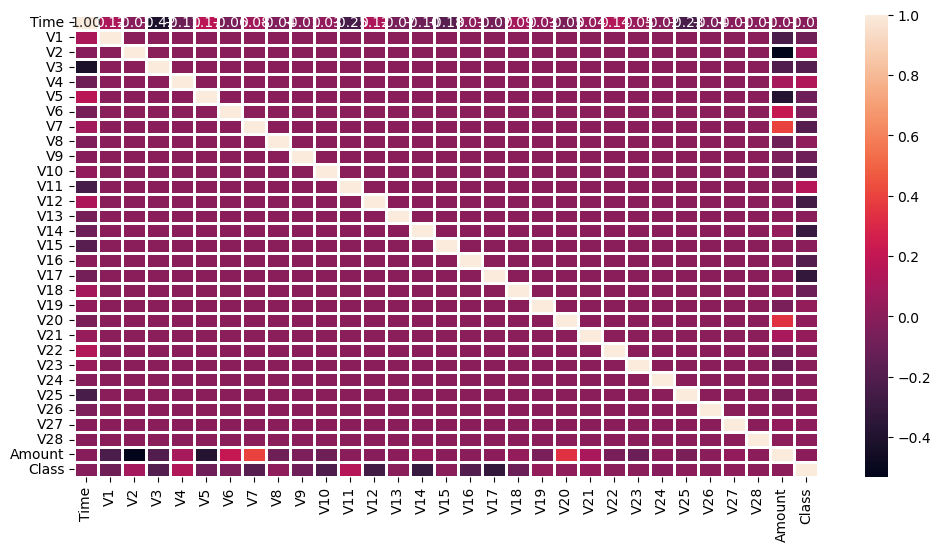

In [5]:
plt.figure(figsize=(12, 6))
sns.heatmap(df.corr(),
            cmap = 'rocket',
            fmt = '.2f',
            linewidths = 2,
            annot = True)

## Graphical Analysis of Instances of Fraud

In [6]:
fraud_counts = df.Class.value_counts()

In [7]:
fraud_counts.value_counts()

284315    1
492       1
Name: Class, dtype: int64

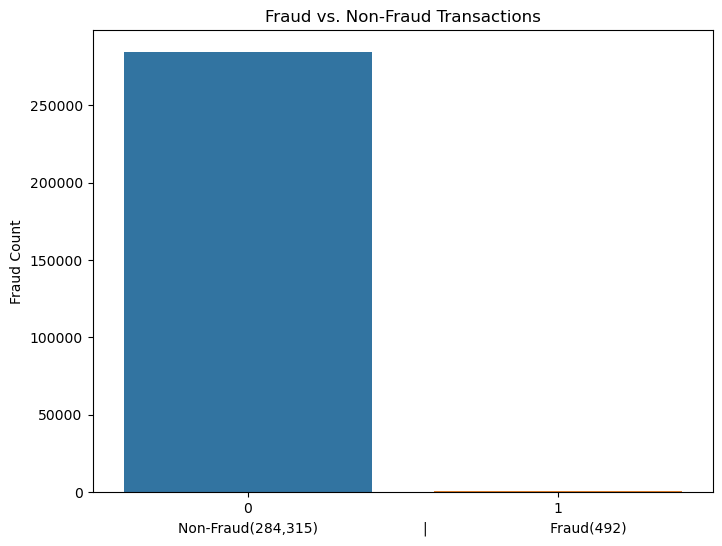

In [8]:
plt.figure(figsize=(8,6))
sns.barplot(x=fraud_counts.index, y=fraud_counts)

plt.title('Fraud vs. Non-Fraud Transactions')
plt.ylabel('Fraud Count')
plt.xlabel('Non-Fraud(284,315)                        |                            Fraud(492)'); 

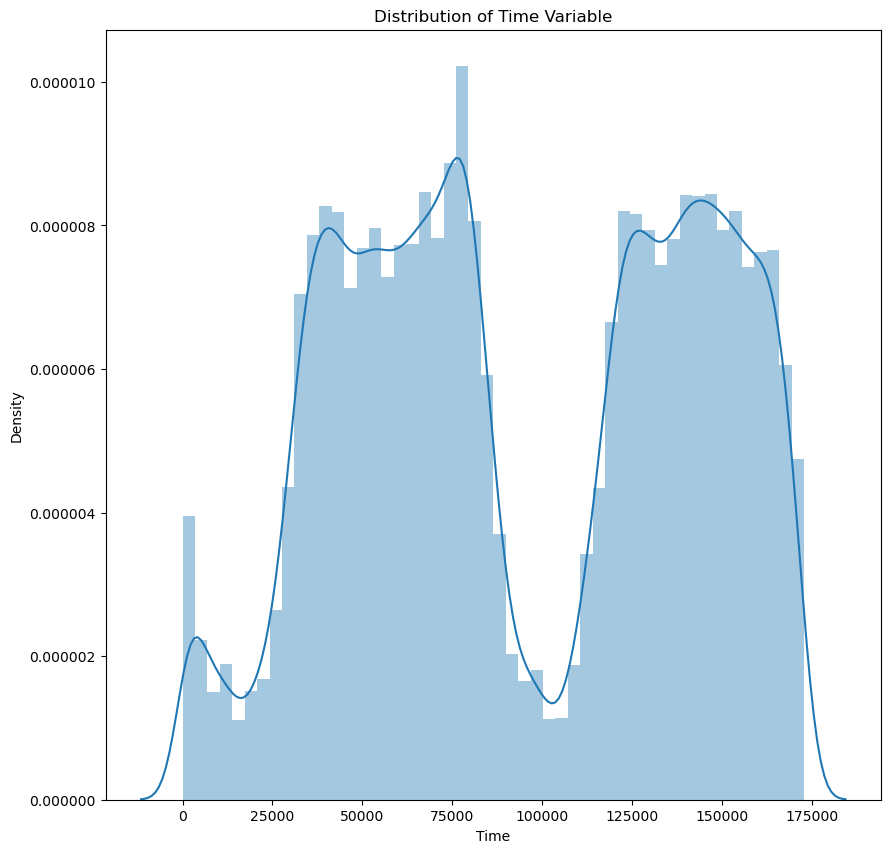

In [9]:
warnings.filterwarnings("ignore")
plt.figure(figsize=(10,10))
plt.ticklabel_format(style='plain', axis='y')
plt.title('Distribution of Time Variable')
sns.distplot(df.Time);

# Data Review and Exploration 

## Missing Data Review

In [10]:
Credit_Card_NaN = df.isna().sum()

print(Credit_Card_NaN)

Time      0
V1        0
V2        0
V3        0
V4        0
V5        0
V6        0
V7        0
V8        0
V9        0
V10       0
V11       0
V12       0
V13       0
V14       0
V15       0
V16       0
V17       0
V18       0
V19       0
V20       0
V21       0
V22       0
V23       0
V24       0
V25       0
V26       0
V27       0
V28       0
Amount    0
Class     0
dtype: int64


## Descriptive Statistics 

In [11]:
df.describe()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
count,284807.000000,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,...,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,284807.000000,284807.000000
mean,94813.859575,3.918649e-15,5.682686e-16,-8.761736e-15,2.811118e-15,-1.552103e-15,2.040130e-15,-1.698953e-15,-1.893285e-16,-3.147640e-15,...,1.473120e-16,8.042109e-16,5.282512e-16,4.456271e-15,1.426896e-15,1.701640e-15,-3.662252e-16,-1.217809e-16,88.349619,0.001727
std,47488.145955,1.958696e+00,1.651309e+00,1.516255e+00,1.415869e+00,1.380247e+00,1.332271e+00,1.237094e+00,1.194353e+00,1.098632e+00,...,7.345240e-01,7.257016e-01,6.244603e-01,6.056471e-01,5.212781e-01,4.822270e-01,4.036325e-01,3.300833e-01,250.120109,0.041527
min,0.000000,-5.640751e+01,-7.271573e+01,-4.832559e+01,-5.683171e+00,-1.137433e+02,-2.616051e+01,-4.355724e+01,-7.321672e+01,-1.343407e+01,...,-3.483038e+01,-1.093314e+01,-4.480774e+01,-2.836627e+00,-1.029540e+01,-2.604551e+00,-2.256568e+01,-1.543008e+01,0.000000,0.000000
25%,54201.500000,-9.203734e-01,-5.985499e-01,-8.903648e-01,-8.486401e-01,-6.915971e-01,-7.682956e-01,-5.540759e-01,-2.086297e-01,-6.430976e-01,...,-2.283949e-01,-5.423504e-01,-1.618463e-01,-3.545861e-01,-3.171451e-01,-3.269839e-01,-7.083953e-02,-5.295979e-02,5.600000,0.000000
50%,84692.000000,1.810880e-02,6.548556e-02,1.798463e-01,-1.984653e-02,-5.433583e-02,-2.741871e-01,4.010308e-02,2.235804e-02,-5.142873e-02,...,-2.945017e-02,6.781943e-03,-1.119293e-02,4.097606e-02,1.659350e-02,-5.213911e-02,1.342146e-03,1.124383e-02,22.000000,0.000000
75%,139320.500000,1.315642e+00,8.037239e-01,1.027196e+00,7.433413e-01,6.119264e-01,3.985649e-01,5.704361e-01,3.273459e-01,5.971390e-01,...,1.863772e-01,5.285536e-01,1.476421e-01,4.395266e-01,3.507156e-01,2.409522e-01,9.104512e-02,7.827995e-02,77.165000,0.000000
max,172792.000000,2.454930e+00,2.205773e+01,9.382558e+00,1.687534e+01,3.480167e+01,7.330163e+01,1.205895e+02,2.000721e+01,1.559499e+01,...,2.720284e+01,1.050309e+01,2.252841e+01,4.584549e+00,7.519589e+00,3.517346e+00,3.161220e+01,3.384781e+01,25691.160000,1.000000


## Types, Shape, and Columns

In [12]:
df.dtypes

Time      float64
V1        float64
V2        float64
V3        float64
V4        float64
V5        float64
V6        float64
V7        float64
V8        float64
V9        float64
V10       float64
V11       float64
V12       float64
V13       float64
V14       float64
V15       float64
V16       float64
V17       float64
V18       float64
V19       float64
V20       float64
V21       float64
V22       float64
V23       float64
V24       float64
V25       float64
V26       float64
V27       float64
V28       float64
Amount    float64
Class       int64
dtype: object

In [13]:
print(df.shape)

(284807, 31)


In [14]:
df.columns

Index(['Time', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10',
       'V11', 'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20',
       'V21', 'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'Amount',
       'Class'],
      dtype='object')

# Data Pre-Processing 

In [15]:
df.drop(['Amount', 'Time'], axis=1, inplace=True)

In [16]:
df.head(2)

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V20,V21,V22,V23,V24,V25,V26,V27,V28,Class
0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,0.090794,...,0.251412,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,0
1,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,-0.166974,...,-0.069083,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,0


## Data Preparation

In [17]:
relation_split = np.random.rand(len(df)) < 0.80
train = df[relation_split]
test = df[~relation_split]
print('Train Shape: {}\nTest Shape:  {}'.format(train.shape, test.shape))

Train Shape: (228124, 29)
Test Shape:  (56683, 29)


In [18]:
train.reset_index(drop=True, inplace=True)
test.reset_index(drop=True, inplace=True)

In [19]:
train_fraud_count = train.Class.value_counts()[1]
print('Incidences of fraudulent credit card transactions in the train data is {}.'.format(train_fraud_count))

Incidences of fraudulent credit card transactions in the train data is 379.


In [20]:
test_fraud_count = test.Class.value_counts()[1]
print('Incidences of fraudulent credit card transactions in the test data is {}.'.format(test_fraud_count))

Incidences of fraudulent credit card transactions in the test data is 113.


In [21]:
non_fraud = train[train['Class'] == 0]

In [22]:
fraud = train[train['Class'] == 1]

In [23]:
selected = non_fraud.sample(train_fraud_count)
selected.head(2)

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V20,V21,V22,V23,V24,V25,V26,V27,V28,Class
11241,1.050282,0.374268,1.520532,2.955253,-0.498195,0.386078,-0.496476,0.085675,1.150913,0.081093,...,-0.176784,-0.017652,0.417898,-0.031292,0.380957,0.413163,0.117036,0.022474,0.025213,0
223128,0.233787,1.233195,0.820715,4.406707,1.029034,0.920296,0.607378,-0.035364,-1.673597,2.107313,...,0.362286,0.198181,1.110482,-0.092180,-0.357598,-1.089632,0.356683,0.387180,0.100889,0


In [24]:
selected.reset_index(drop=True, inplace=True)
fraud.reset_index(drop=True, inplace=True)

In [25]:
subsample = pd.concat([selected, fraud])
len(subsample)

758

In [26]:
subsample = subsample.sample(frac=1).reset_index(drop=True)
subsample.head(2)

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V20,V21,V22,V23,V24,V25,V26,V27,V28,Class
0,-6.352337,-2.370335,-4.875397,2.335045,-0.809555,-0.413647,-4.082308,2.239089,-1.98636,-5.165331,...,0.186898,1.325218,1.226745,-1.485217,-1.470732,-0.240053,0.112972,0.910591,-0.650944,1
1,1.725403,-1.705252,-2.430272,-2.281663,-0.239518,-0.675979,0.239989,-0.393263,-0.04333,-0.000939,...,0.034244,-0.071524,-0.128538,-0.183118,0.274406,0.175173,-0.161146,-0.062161,-0.023556,0


In [27]:
# subsample.describe()

In [28]:
# subsample.info()

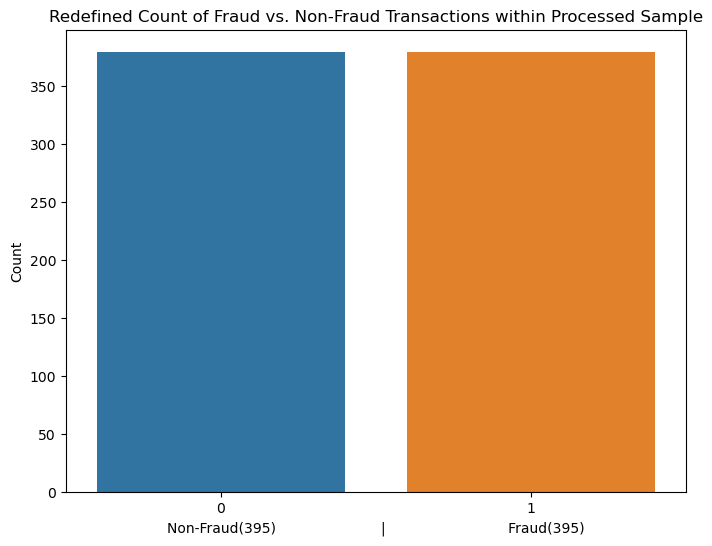

In [29]:
new_counts = subsample.Class.value_counts()
plt.figure(figsize=(8,6))
sns.barplot(x=new_counts.index, y=new_counts)

plt.title('Redefined Count of Fraud vs. Non-Fraud Transactions within Processed Sample')
plt.ylabel('Count')
plt.xlabel('Non-Fraud(395)                        |                            Fraud(395)'); 

# Modeling

### Data Model: Random Forest Classifier

In [30]:
df2 = df.copy()

In [31]:
X = df2.drop('Class', axis=1)
y = df2['Class']

In [32]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [33]:
X_train = X_train.values
X_validation = X_test.values
y_train = y_train.values
y_validation = y_test.values

In [34]:
model = RandomForestClassifier()

In [35]:
model.fit(X_train, y_train)

RandomForestClassifier()

In [36]:
y_pred = model.predict(X_test)

In [37]:
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

Accuracy: 0.9995259997893332


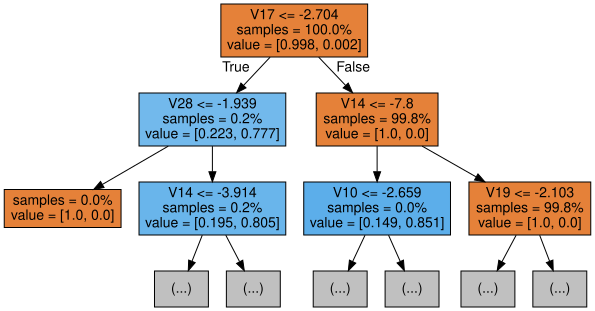

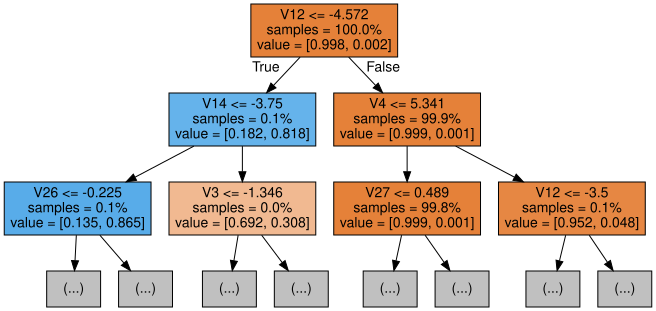

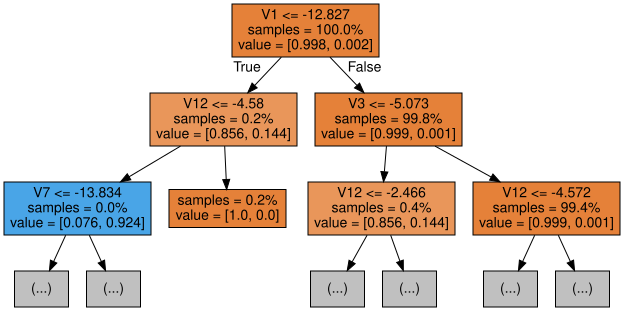

In [38]:
for i in range(3):
    tree = model.estimators_[i]
    dot_data = export_graphviz(tree,
                               feature_names=X.columns.tolist(),  
                               filled=True,  
                               max_depth=2, 
                               impurity=False, 
                               proportion=True)
    graph = graphviz.Source(dot_data)
    display(graph)

In [39]:
estimator = model.estimators_[5]

In [40]:
export_graphviz(estimator, out_file = 'tree.dot', 
                feature_names = X.columns.tolist(),
                class_names = ['0',' 1'],
                rounded = True, proportion = False, 
                precision = 2, filled = True)

In [41]:
call(['dot', '-Tpng', 'tree.dot', '-o', 'tree.png', '-Gdpi=600'])

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.869151 to fit


0

In [43]:
Image(filename = 'tree.png')